# Analyse the Classification performance under Frequency Manipulations. 


In [2]:
WORKDIR = "/home/wustl/Dummy/Wustl/Deepfake/MasterThesis"  # specify WORKDIR here

### Imports

In [3]:

import matplotlib.pyplot as plt
import numpy as np 
import json
import os 
import json
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

import seaborn as sns


from paper_utils import get_figsize, configure_matplotlib, create_subplot_mosaic
from calculate_MMD import get_files_from_directory,get_files_from_sub_directory


Generators = ["ProGAN", "StyleGAN", "ProjectedGAN", "Diff-StyleGAN2", "Diff-ProjectedGAN", "DDPM", "IDDPM", "ADM", "PNDM", "LDM","coco", "all","gan","diff"]#

Gans = ["ProGAN", "StyleGAN", "ProjectedGAN", "Diff-StyleGAN2", "Diff-ProjectedGAN"]
Diffs = ["DDPM", "IDDPM", "ADM", "PNDM", "LDM"]



Base functions

In [4]:
configure_matplotlib(
    rc={
        "xtick.labelbottom": False,
        "xtick.bottom": True,
        "xtick.labeltop": True,
        "ytick.left": True,
        "ytick.right": False,
        "figure.constrained_layout.use": False,
        "savefig.pad_inches": 0.01,
    }
)


In [5]:
experiments = {}
path_names = []
base_input_folder = "/home/wustl/Dummy/Wustl/Deepfake/MasterThesis/results/classification/butt_low_5_ce"
all_files = get_files_from_directory(base_input_folder)


for experiment_name, files in all_files.items():
    if experiment_name not in Generators:
        continue
    for file in files:
        parts = file.split("/")[-1].split("_")
        generator_type = parts[-1].split(".")[0]
        model_name = parts[0]
        
        try:
            with open(file, "r") as input_file:  # Assuming JSON file
                results = json.load(input_file)
        except Exception as e:
            print(f"Error reading {file}: {e}")
            continue
        #print(experiment_name)
        #print(generator_type)
        experiments.setdefault(
            model_name, {}).setdefault(
                experiment_name, {}).setdefault(
                    generator_type, {key: 
                                     {metric: metric_value for metrics in value for metric, metric_value in metrics.items()} 
                                     for step in results for key, value in step.items()
                                     })      

data = []
for encoder_name, experiment_dict in experiments.items():
    for experiment_name, generator_dict in experiment_dict.items():
        for generator_type, metrics_dict in generator_dict.items():
            for number, metrics in metrics_dict.items():
                # Create a dictionary for each combination
                flattened_dict = {
                    'Encoder': encoder_name,
                    'Experiment': experiment_name,
                    'Generator': generator_type,
                    'Number': number
                }
                # Add all metrics to this dictionary
                flattened_dict.update(metrics)
                data.append(flattened_dict)

# Converting to a DataFrame
df = pd.DataFrame(data)
df['tendency_to_overclassify_positive'] = 1 - df['test_precision']
    
df['tendency_to_overclassify_negative'] = 1 - df['test_recall']
df.to_csv("classification_results.csv")


### Compare the two generators.

First, we aim to understand the behavior of the two generators trained on specific data when no filters are applied. We want to determine, under normal conditions, which model better handles the introduction of new types of generators, and whether there are any tendencies to overclassify as either fake or real

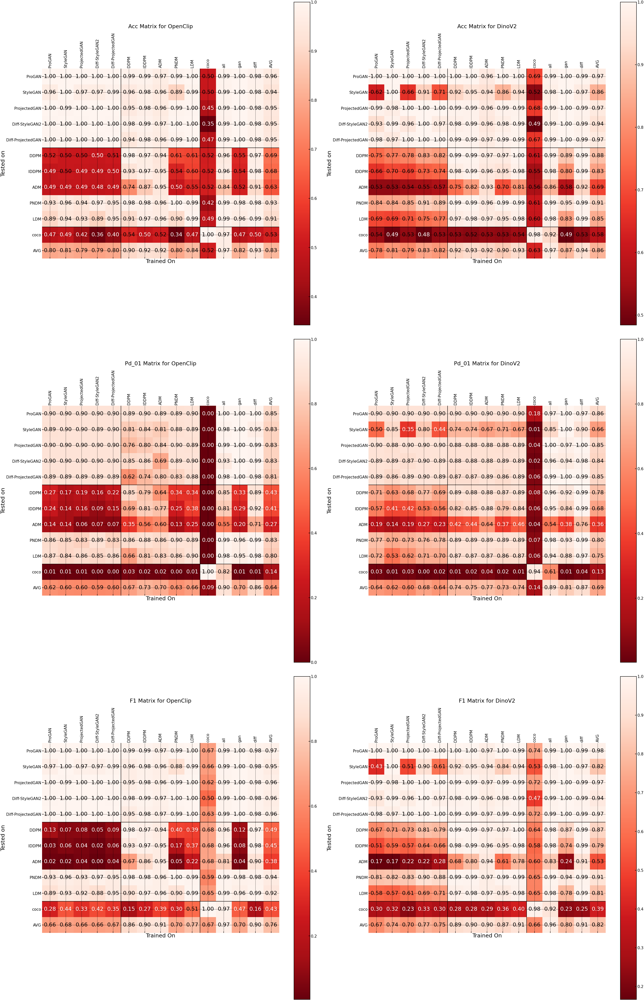

In [12]:


import numpy as np
import matplotlib.pyplot as plt

# Filter DataFrame for rows where 'Number' is "no"
df_filtered = df[(df['Number'] == "no")]*100



# Assuming we have two models: Model A and Model B
model_a = "OpenClip"  # Replace with the actual key for Model A
model_b = "DinoV2"  # Replace with the actual key for Model B
Test_Columns = ["ProGAN", "StyleGAN", "ProjectedGAN", "Diff-StyleGAN2", "Diff-ProjectedGAN", "DDPM", "IDDPM", "ADM", "PNDM", "LDM","coco"]
# Generators = ["ProGAN", "StyleGAN", "ProjectedGAN", "Diff-StyleGAN2", "Diff-ProjectedGAN", "DDPM", "IDDPM", "ADM", "PNDM", "LDM", "coco"]
metrics = ['test_acc', 'test_pd_01', 'test_f1']
gan_diff_separation_idx = Generators.index("DDPM")
df_filtered = df_filtered[df_filtered['Generator'].isin(Test_Columns)]
# Create a figure with subplots for each metric
fig, axes = plt.subplots(len(metrics), 2, figsize=(12, 6 * len(metrics)))  # Adjust the figure size as needed

separation_idx = [Generators.index("DDPM"), Generators.index("coco")]#
# Iterate over each metric
for i, metric in enumerate(metrics):
    # Create pivot tables for each model and metric
    # Create pivot tables with swapped rows and columns
    # Create pivot tables for each model and metric
    pivot_a = df_filtered[df_filtered['Encoder'] == model_a].pivot(index='Generator', columns='Experiment', values=metric)
    pivot_b = df_filtered[df_filtered['Encoder'] == model_b].pivot(index='Generator', columns='Experiment', values=metric)
    
    # Reindex pivot tables to ensure order of Generators
    # Calculate row averages for pivot_a and pivot_b and add as a new column 'AVG'
    pivot_a['AVG'] = pivot_a.mean(axis=1)
    pivot_b['AVG'] = pivot_b.mean(axis=1)
    
    # Calculate column averages for pivot_a and pivot_b and add as a new row 'AVG'
    pivot_a.loc['AVG'] = pivot_a.mean(axis=0)
    pivot_b.loc['AVG'] = pivot_b.mean(axis=0)

    # Update Generators list to include 'AVG'
    Generators_with_avg = Generators + ['AVG']
    Test_Columns_with_avg = Test_Columns + ['AVG']

    # Reindex pivot tables to include the 'AVG' row and column
    pivot_a = pivot_a.reindex(index=Test_Columns_with_avg, columns=Generators_with_avg)
    pivot_b = pivot_b.reindex(index=Test_Columns_with_avg, columns=Generators_with_avg)

    # Replace NaN values with zeros if necessary
    pivot_a = pivot_a.fillna(0)
    pivot_b = pivot_b.fillna(0)

    # Convert pivot tables to numpy arrays for plotting
    matrix_a = pivot_a.to_numpy()
    matrix_b = pivot_b.to_numpy()
    
    # Update the plots, axes titles and labels
    # First subplot for Model A
    cax1 = axes[i, 0].imshow(matrix_a, cmap=plt.cm.Reds_r)
    fig.colorbar(cax1, ax=axes[i, 0])
    axes[i, 0].set_xticks(np.arange(len(Generators_with_avg)))
    axes[i, 0].set_yticks(np.arange(len(Test_Columns_with_avg)))
    axes[i, 0].set_xticklabels(Generators_with_avg, rotation=90)
    axes[i, 0].set_yticklabels(Test_Columns_with_avg)
    axes[i, 0].set_xlabel('Trained On')
    axes[i, 0].set_ylabel('Tested on')
    axes[i, 0].set_title(f'{metric.replace("test_", "").capitalize()} Matrix for {model_a}')
    axes[i, 0].spines[:].set_visible(False)
    axes[i, 0].grid(which="minor", color="w", linestyle='-', linewidth=3)

    # Second subplot for Model B
    cax2 = axes[i, 1].imshow(matrix_b, cmap=plt.cm.Reds_r)
    fig.colorbar(cax2, ax=axes[i, 1])
    axes[i, 1].set_xticks(np.arange(len(Generators_with_avg)))
    axes[i, 1].set_yticks(np.arange(len(Test_Columns_with_avg)))
    axes[i, 1].set_xticklabels(Generators_with_avg, rotation=90)
    axes[i, 1].set_yticklabels(Test_Columns_with_avg)
    axes[i, 1].set_xlabel('Trained On')
    axes[i, 1].set_ylabel('Tested on')
    axes[i, 1].set_title(f'{metric.replace("test_", "").capitalize()} Matrix for {model_b}')
    axes[i, 1].spines[:].set_visible(False)
    axes[i, 1].grid(which="minor", color="w", linestyle='-', linewidth=3)
    for sep in separation_idx:
        axes[i, 0].axhline(y=sep-0.5, color='black', linewidth=0.5)  # Horizontal line
        axes[i, 0].axvline(x=sep-0.5, color='black', linewidth=0.5)  # Vertical line

        axes[i, 1].axhline(y=sep-0.5, color='black', linewidth=0.5)  # Horizontal line
        axes[i, 1].axvline(x=sep-0.5, color='black', linewidth=0.5)  # Vertical line

    #Adding value annotations for both matrices
    for ax, matrix in zip((axes[i, 0], axes[i, 1]), (matrix_a, matrix_b)):
        for (i, j), val in np.ndenumerate(matrix):
            text_color = 'white' if val < 0.5 else 'black'
            ax.text(j, i, f"{val:.2f}", ha='center', va='center', color=text_color)
    
plt.tight_layout()
plt.show()

In [7]:

df_filtered = df[(df['Experiment'] != 'coco') & (df['Generator'] != 'coco')  ]

# Categorize each row based on whether it's in Gans or Diffs
#df_filtered['Category'] = df_filtered['Experiment'].apply(lambda x: 'Gans' if x in Gans else ('Diffs' if x in Diffs else 'Other'))

# Now, group by Encoder, Number, and the new Category
average_acc_by_model_filter_category = df_filtered.groupby(['Encoder', 'Number'])['test_acc'].mean()

# Find the maximum average accuracy for each model and category
max_average_acc_by_model_category = average_acc_by_model_filter_category.groupby(level=[0, 2]).idxmax()
max_average_values_by_model_category = average_acc_by_model_filter_category.groupby(level=[0, 2]).max()

# Display the results
print(f"The filters with the maximum average accuracy for each model and category are:\n{max_average_acc_by_model_category}")
print(f"The maximum average accuracy values for each model and category are:\n{max_average_values_by_model_category}")

/tmp/ipykernel_683353/4022016563.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Category'] = df_filtered['Experiment'].apply(lambda x: 'Gans' if x in Gans else ('Diffs' if x in Diffs else 'Other'))


IndexError: Too many levels: Index has only 2 levels, not 3

We observe that CLIP faces greater challenges in handling models trained with diffusion techniques when the training data is generated by GANs. However, CLIP performs more effectively on COCO datasets when trained on GANs and diffusion methods respectively. It is also noted that CLIP tends to classify images as real when confronted with new types of generators. Therefore, in the following section, we should make a distinction between models trained with GANs and those trained with diffusion techniques.

### The Impact of Frequency Removal on the Classification Performace. 

To determine whether specific frequency bands are crucial for classifying a given generator's output, we employ a low-pass Butterworth filter on the images. The advantage of using a Butterworth filter is its reduced creation of 'ripples' or artifacts in the inverse Fourier transform. We incrementally increase the filter with a step size of 5 to observe its impact on classification performance. It's essential to consider both False Positive and False Negative Rates. A high False Positive rate might suggest a tendency to incorrectly label fake images as real, while a high False Negative rate could indicate a bias towards classifying images as real.

Our first step is to compare the two models across all experiments and generators, excluding COCO-trained models and the models' performance on their own data to ensure a fair comparison. We then plot the recall to check if the model is erroneously overclassifying fake images as real, effectively 'dumping' them into the real category.

We also plot the precision to determine if the model is mistakenly overclassifying real images as fake, thus 'dumping' them into the fake category.

Given the earlier observation of clear differences between models trained on GANs and those on diffusion models, our objective is to identify the potential reasons behind these variations.


### DIFF Generated Gan Tested

We check how Diff Models behave when tested on GANs filtered with masks.

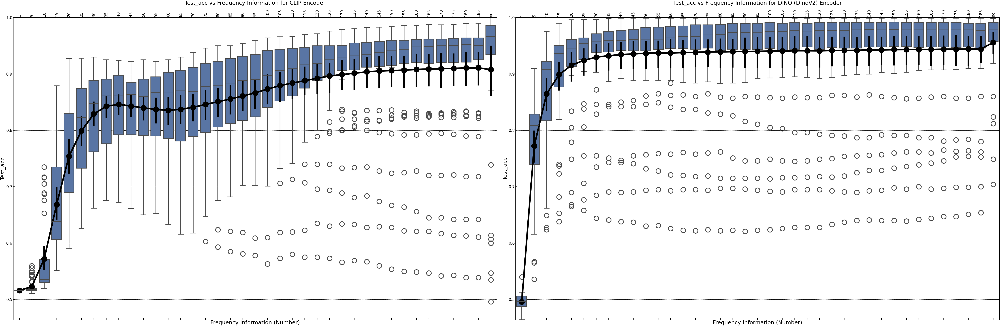

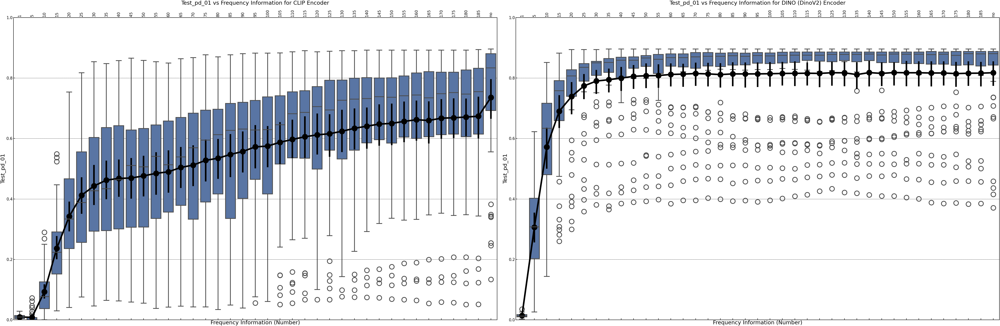

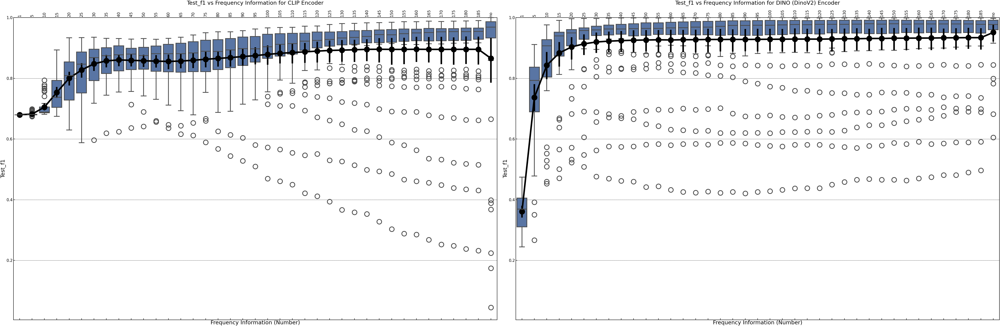

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt


filtered_data = df[(df['Experiment'] != 'coco') & (df['Generator'] != 'coco') ]#& (df['Generator'] != 'ADM')
filtered_data = filtered_data[filtered_data['Generator'] != filtered_data['Experiment']]
dino_data_corrected = filtered_data[filtered_data['Encoder'] == 'DinoV2']
clip_data = filtered_data[filtered_data['Encoder'] == 'OpenClip']
metrics = ['test_acc', 'test_pd_01', 'test_f1']
sns.set_palette('deep')


dino_data_corrected = dino_data_corrected[(dino_data_corrected["Experiment"].isin(Diffs))]
clip_data = clip_data[(clip_data["Experiment"].isin(Diffs))]
# # Creating a figure for each metric
for metric in metrics:
    global_min_y = filtered_data[metric].min()
    global_max_y = filtered_data[metric].max()
    plt.figure(figsize=(18, 6))

    # Boxplot for CLIP encoder
    plt.subplot(1, 2, 1)
    
    sns.boxplot(x='Number', y=metric, data=clip_data)
    sns.pointplot(x='Number', y=metric, data=clip_data, color='black', markersize=6, linewidth=2)
    plt.xticks(rotation=90)
    plt.ylim(global_min_y, global_max_y) 
    plt.title(f'{metric.capitalize().replace("test_", "")} vs Frequency Information for CLIP Encoder')
    plt.xlabel('Frequency Information (Number)')
    plt.ylabel(metric.capitalize().replace("test_", ""))

    # Boxplot for DINO (DinoV2) encoder
    plt.subplot(1, 2, 2)
    if not dino_data_corrected.empty:
        sns.boxplot(x='Number', y=metric, data=dino_data_corrected)
        sns.pointplot(x='Number', y=metric, data=dino_data_corrected, color='black', markersize=6, linewidth=2)
        plt.xticks(rotation=90)
        plt.ylim(global_min_y, global_max_y) 
        plt.title(f'{metric.capitalize().replace("test_", "")} vs Frequency Information for DINO (DinoV2) Encoder')
        plt.xlabel('Frequency Information (Number)')
        plt.ylabel(metric.capitalize().replace("test_", ""))
    else:
        plt.text(0.5, 0.5, 'No data available for DINO (DinoV2) Encoder', 
                 horizontalalignment='center', verticalalignment='center', 
                 transform=plt.gca().transAxes)
        plt.title('Data Unavailable for DINO (DinoV2)')

    plt.tight_layout()
    plt.show()

### Gan Generated Diff Tested

We check how Diff Models behave when tested on GANs filtered with masks.

Following the opservation, that the models trained on the gan images perform worse on the DM generated images, we want to see if this is due to a bias twoards a certain frequency spectrum. 

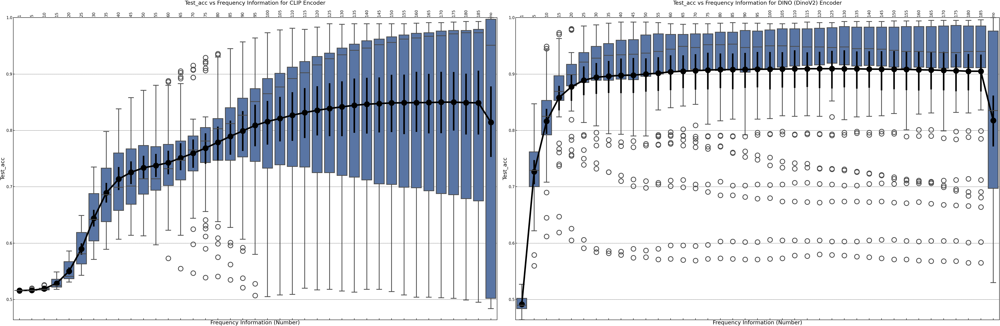

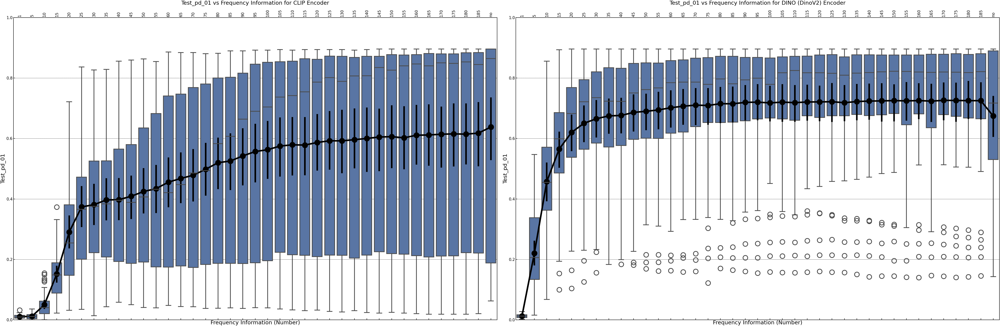

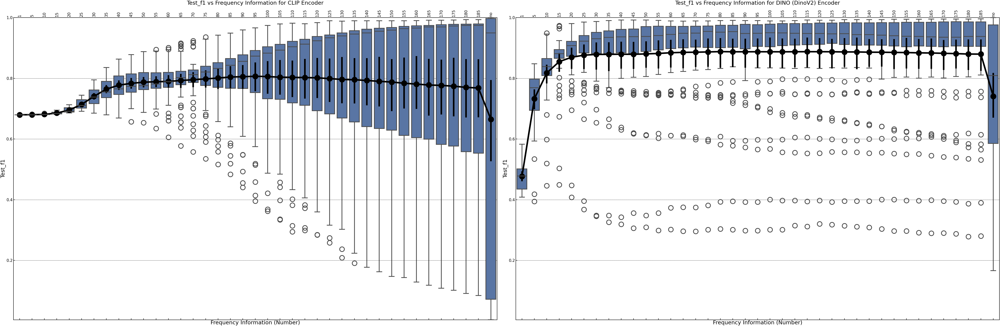

In [8]:
filtered_data = df[(df['Experiment'] != 'coco') & (df['Generator'] != 'coco')]#
filtered_data = filtered_data[filtered_data['Generator'] != filtered_data['Experiment']]
dino_data_corrected = filtered_data[filtered_data['Encoder'] == 'DinoV2']
clip_data = filtered_data[filtered_data['Encoder'] == 'OpenClip']
metrics = ['test_acc', 'test_pd_01', 'test_f1']
sns.set_palette('deep')

dino_data_corrected = dino_data_corrected[(dino_data_corrected["Experiment"].isin(Gans))]
clip_data = clip_data[(clip_data["Experiment"].isin(Gans))]
# Creating a figure for each metric
for metric in metrics:
    global_min_y = filtered_data[metric].min()
    global_max_y = filtered_data[metric].max()
    plt.figure(figsize=(18, 6))

    # Boxplot for CLIP encoder
    plt.subplot(1, 2, 1)
    
    sns.boxplot(x='Number', y=metric, data=clip_data)
    sns.pointplot(x='Number', y=metric, data=clip_data, color='black', markersize=6, linewidth=2)
    plt.xticks(rotation=90)
    plt.ylim(global_min_y, global_max_y) 
    plt.title(f'{metric.capitalize().replace("test_", "")} vs Frequency Information for CLIP Encoder')
    plt.xlabel('Frequency Information (Number)')
    plt.ylabel(metric.capitalize().replace("test_", ""))

    # Boxplot for DINO (DinoV2) encoder
    plt.subplot(1, 2, 2)
    if not dino_data_corrected.empty:
        sns.boxplot(x='Number', y=metric, data=dino_data_corrected)
        sns.pointplot(x='Number', y=metric, data=dino_data_corrected, color='black', markersize=6, linewidth=2)
        plt.xticks(rotation=90)
        plt.ylim(global_min_y, global_max_y) 
        plt.title(f'{metric.capitalize().replace("test_", "")} vs Frequency Information for DINO (DinoV2) Encoder')
        plt.xlabel('Frequency Information (Number)')
        plt.ylabel(metric.capitalize().replace("test_", ""))
    else:
        plt.text(0.5, 0.5, 'No data available for DINO (DinoV2) Encoder', 
                 horizontalalignment='center', verticalalignment='center', 
                 transform=plt.gca().transAxes)
        plt.title('Data Unavailable for DINO (DinoV2)')

    plt.tight_layout()
    plt.show()

We observe that CLIP tends to classify all images as fake in the absence of high-frequency information. As more frequency information is introduced, its rate of missing fake images increases. Conversely, Dino's recall improves with more information, suggesting that it considers low-frequency domains in its decision-making, especially when trained on GAN images. Both models have learned to focus on higher frequencies for classifying GAN-generated images, although lower frequencies also play a significant role for Dino.

The precision analysis reveals that Dino quickly reduces the false positive rate, suggesting it's less likely to misclassify an image as fake when lower frequencies are present. This data indicates Dino's ability to utilize lower frequency bands effectively in classification.

Considering this, an approach could be to identify the frequency at which models on average perform best for either GAN or diffusion-based generation. GANs tend to produce more noise at higher frequencies compared to diffusion models. This discrepancy leads to challenges when models trained on GANs encounter diffusion models, as suggested by existing research. Dino seems to encode lower frequencies more effectively than CLIP, highlighting its robustness to unseen generators due to the lower propensity for noise in these bands.

To leverage the lower frequencies, we propose training models with a low-pass filter. It's crucial to apply this filter to all images, as the encoder's weights remain unaltered, allowing it to correctly produce embeddings of unfiltered images. The focus is on training the classification layer to emphasize lower frequencies. If successful, Dino should classify unseen generators more accurately by utilizing these frequencies. This could improve foundation models by encoding more low-frequency information, beneficial for various tasks.

The training paradigms for Dino and CLIP differ, with Dino employing a Gaussian blur (a form of low-pass filter) on all student data during training. This practice may explain Dino's superior performance in lower frequency ranges, offering advantages in tasks where high-frequency information alone is insufficient.

In contrast to a previous paper's claim that low-pass filtering makes models indistinguishable, our findings suggest low-pass filtering actually improves performance. Additionally, higher frequencies in diffusion models show similar artifacts to natural images compressed with JPEG, as noted in a Fourier analysis paper. Interestingly, Dino can differentiate between GANs and diffusion models better in the mid-frequency range than in the high-frequency range.

This analysis proposes that Dino's superior low-frequency encoding, likely due to its training augmentations like Gaussian Blur, contributes to its effectiveness in distinguishing between GAN and diffusion-generated images, especially in the presence of noise and compression artifacts.



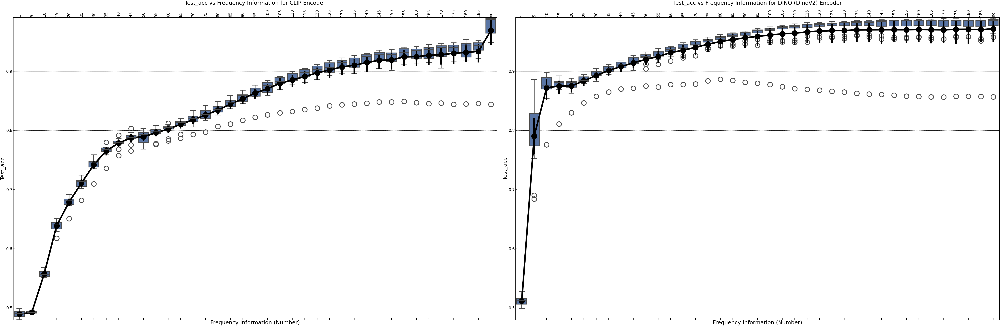

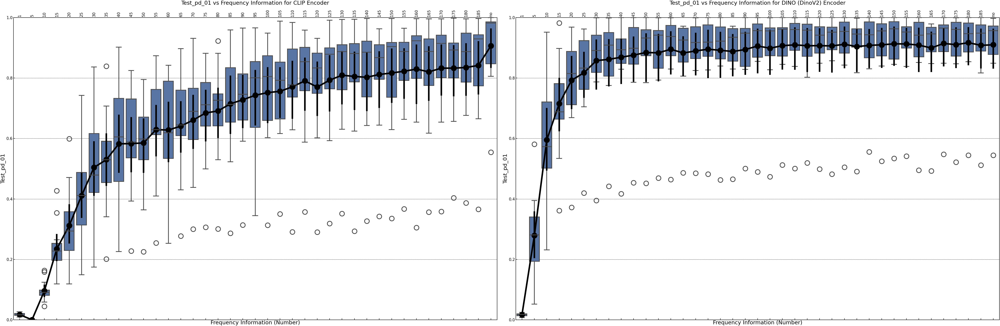

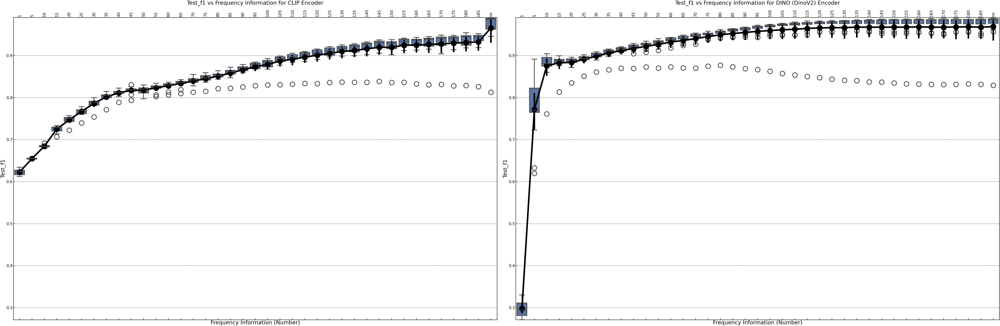

In [9]:
filtered_data = df[(df['Generator'] == 'coco')& (df['Experiment'] == 'coco')]
#filtered_data = filtered_data[filtered_data['Generator'] != filtered_data['Experiment']]
dino_data_corrected = filtered_data[filtered_data['Encoder'] == 'DinoV2']
clip_data = filtered_data[filtered_data['Encoder'] == 'OpenClip']
metrics = ['test_acc', 'test_pd_01', 'test_f1']
sns.set_palette('deep')


#dino_data_corrected = dino_data_corrected[(dino_data_corrected["Generator"].isin(Diffs))]
#clip_data = clip_data[(clip_data["Generator"].isin(Diffs))]
# Creating a figure for each metric
for metric in metrics:
    global_min_y = filtered_data[metric].min()
    global_max_y = filtered_data[metric].max()
    plt.figure(figsize=(18, 6))

    # Boxplot for CLIP encoder
    plt.subplot(1, 2, 1)
    
    sns.boxplot(x='Number', y=metric, data=clip_data)
    sns.pointplot(x='Number', y=metric, data=clip_data, color='black', markersize=6, linewidth=2)
    plt.xticks(rotation=90)
    plt.ylim(global_min_y, global_max_y) 
    plt.title(f'{metric.capitalize().replace("test_", "")} vs Frequency Information for CLIP Encoder')
    plt.xlabel('Frequency Information (Number)')
    plt.ylabel(metric.capitalize().replace("test_", ""))

    # Boxplot for DINO (DinoV2) encoder
    plt.subplot(1, 2, 2)
    if not dino_data_corrected.empty:
        sns.boxplot(x='Number', y=metric, data=dino_data_corrected)
        sns.pointplot(x='Number', y=metric, data=dino_data_corrected, color='black', markersize=6, linewidth=2)
        plt.xticks(rotation=90)
        plt.ylim(global_min_y, global_max_y) 
        plt.title(f'{metric.capitalize().replace("test_", "")} vs Frequency Information for DINO (DinoV2) Encoder')
        plt.xlabel('Frequency Information (Number)')
        plt.ylabel(metric.capitalize().replace("test_", ""))
    else:
        plt.text(0.5, 0.5, 'No data available for DINO (DinoV2) Encoder', 
                 horizontalalignment='center', verticalalignment='center', 
                 transform=plt.gca().transAxes)
        plt.title('Data Unavailable for DINO (DinoV2)')

    plt.tight_layout()
    plt.show()

Now we check, if face with the same datatype, if model has different behaviour. We



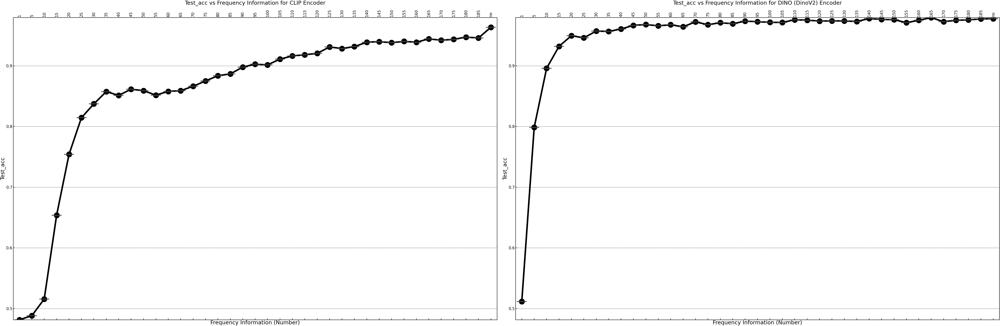

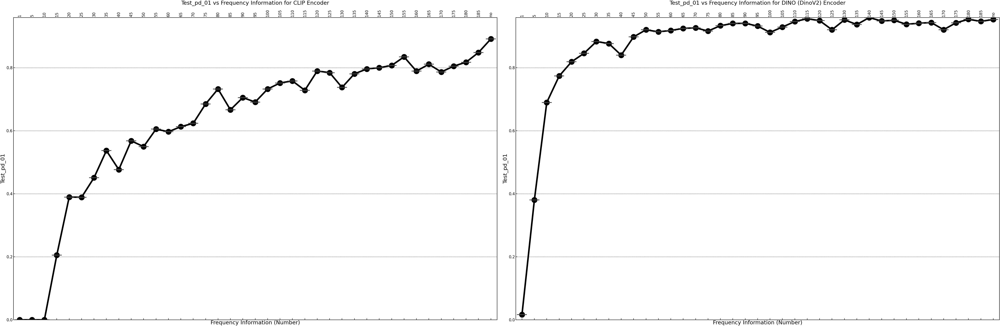

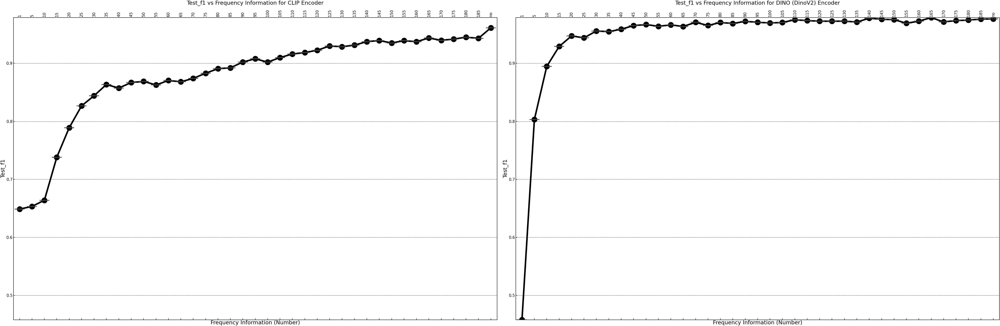

In [14]:
filtered_data = df[(df['Generator'] == df['Experiment'])& (df['Experiment'] == 'diff')]
dino_data_corrected = filtered_data[filtered_data['Encoder'] == 'DinoV2']
clip_data = filtered_data[filtered_data['Encoder'] == 'OpenClip']
metrics = ['test_acc', 'test_pd_01', 'test_f1']
sns.set_palette('deep')
# Creating a figure for each metric
for metric in metrics:
    global_min_y = filtered_data[metric].min()
    global_max_y = filtered_data[metric].max()
    plt.figure(figsize=(18, 6))

    # Boxplot for CLIP encoder
    plt.subplot(1, 2, 1)
    
    sns.boxplot(x='Number', y=metric, data=clip_data)
    sns.pointplot(x='Number', y=metric, data=clip_data, color='black', markersize=6, linewidth=2)
    plt.xticks(rotation=90)
    plt.ylim(global_min_y, global_max_y) 
    plt.title(f'{metric.capitalize().replace("test_", "")} vs Frequency Information for CLIP Encoder')
    plt.xlabel('Frequency Information (Number)')
    plt.ylabel(metric.capitalize().replace("test_", ""))

    # Boxplot for DINO (DinoV2) encoder
    plt.subplot(1, 2, 2)
    if not dino_data_corrected.empty:
        sns.boxplot(x='Number', y=metric, data=dino_data_corrected)
        sns.pointplot(x='Number', y=metric, data=dino_data_corrected, color='black', markersize=6, linewidth=2)
        plt.xticks(rotation=90)
        plt.ylim(global_min_y, global_max_y) 
        plt.title(f'{metric.capitalize().replace("test_", "")} vs Frequency Information for DINO (DinoV2) Encoder')
        plt.xlabel('Frequency Information (Number)')
        plt.ylabel(metric.capitalize().replace("test_", ""))
    else:
        plt.text(0.5, 0.5, 'No data available for DINO (DinoV2) Encoder', 
                 horizontalalignment='center', verticalalignment='center', 
                 transform=plt.gca().transAxes)
        plt.title('Data Unavailable for DINO (DinoV2)')

    plt.tight_layout()
    plt.show()

If there is an easy distinction for example in the high frequency specturm for a model, that model should generally be better performing when when a input data also has that aspect. 

Here we compare how the different experiments behave. To Ensure no domain shift problems within the lsun trained generators. 

We also seperate between Gans and diffusion trained models. So that the generator will be diffs if trained on a gan and visa versa for diffs.

To better compare the plots, we have to 

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

data = df
data = data[data['Generator'] != "coco"]
data["Number"].replace("no", 200, inplace=True)
dino_data_corrected = data[data['Encoder'] == 'DinoV2']
clip_data = data[data['Encoder'] == 'OpenClip']
sns.set_palette('deep')
head_key = "Experiment"
y = "test_pd_01"
plt.figure(figsize=(18, len(data[head_key].unique()) * 6))

# Find global y-axis limits
global_min_y = data[y].min()
global_max_y = data[y].max()

for i, experiment in enumerate(data[head_key].unique()):
    dino_experiment_data = dino_data_corrected[dino_data_corrected[head_key] == experiment]
    clip_experiment_data = clip_data[clip_data[head_key] == experiment]

    # Similar filtering for Gans and Diffs...

    # if experiment in Gans:
    #     dino_experiment_data = dino_experiment_data[dino_experiment_data["Generator"].isin(Diffs)]
    #     clip_experiment_data = clip_experiment_data[clip_experiment_data["Generator"].isin(Diffs)]
    # elif experiment in Diffs:
    #     dino_experiment_data = dino_experiment_data[dino_experiment_data["Generator"].isin(Gans)]
    #     clip_experiment_data = clip_experiment_data[clip_experiment_data["Generator"].isin(Gans)]

    # Boxplot for CLIP encoder
    plt.subplot(len(data[head_key].unique()), 2, 2*i + 1)
    if not clip_experiment_data.empty:
        sns.boxenplot(x='Number', y=y, data=clip_experiment_data, color='lightgray')
        sns.pointplot(x='Number', y=y, data=clip_experiment_data, color='black')
        plt.xticks(rotation=90)
        plt.ylim(global_min_y, global_max_y)  # Set the global y-axis limits
        plt.title(f'F1 Score vs Frequency Information for CLIP Encoder - {experiment}')
        plt.xlabel('Frequency Information (Number)')
        plt.ylabel('F1 Score')
    else:
        plt.text(0.5, 0.5, f'No data available for CLIP Encoder - {experiment}', 
                 horizontalalignment='center', verticalalignment='center', 
                 transform=plt.gca().transAxes)
        plt.title(f'Data Unavailable for CLIP - {experiment}')

    # Boxplot for DINO (DinoV2) encoder
    plt.subplot(len(data[head_key].unique()), 2, 2*i + 2)
    if not dino_experiment_data.empty:
        sns.boxenplot(x='Number', y=y, data=dino_experiment_data, color='lightgray')
        sns.pointplot(x='Number', y=y, data=dino_experiment_data, color='black')
        plt.xticks(rotation=90)
        plt.ylim(global_min_y, global_max_y)  # Set the global y-axis limits
        plt.title(f'F1 Score vs Frequency Information for DINO (DinoV2) Encoder - {experiment}')
        plt.xlabel('Frequency Information (Number)')
        plt.ylabel('F1 Score')
    else:
        plt.text(0.5, 0.5, f'No data available for DINO (DinoV2) Encoder - {experiment}', 
                 horizontalalignment='center', verticalalignment='center', 
                 transform=plt.gca().transAxes)
        plt.title(f'Data Unavailable for DINO (DinoV2) - {experiment}')

plt.tight_layout()
plt.show()


/tmp/ipykernel_463059/3226722537.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["Number"].replace("no", 200, inplace=True)


In [12]:
import matplotlib.pyplot as plt
import seaborn as sns

data = df
data = data[data['Generator'] != "coco"]
data["Number"].replace("no", 200, inplace=True)
dino_data_corrected = data[data['Encoder'] == 'DinoV2']
clip_data = data[data['Encoder'] == 'OpenClip']
sns.set_palette('deep')
head_key = "Generator"
y = "test_pd_01"
plt.figure(figsize=(18, len(data[head_key].unique()) * 6))

# Find global y-axis limits
global_min_y = data[y].min()
global_max_y = data[y].max()

for i, experiment in enumerate(data[head_key].unique()):
    dino_experiment_data = dino_data_corrected[dino_data_corrected[head_key] == experiment]
    clip_experiment_data = clip_data[clip_data[head_key] == experiment]

    # Similar filtering for Gans and Diffs...

    # if experiment in Gans:
    #     dino_experiment_data = dino_experiment_data[dino_experiment_data["Experiment"].isin(Diffs)]
    #     clip_experiment_data = clip_experiment_data[clip_experiment_data["Experiment"].isin(Diffs)]
    # elif experiment in Diffs:
    #     dino_experiment_data = dino_experiment_data[dino_experiment_data["Experiment"].isin(Gans)]
    #     clip_experiment_data = clip_experiment_data[clip_experiment_data["Experiment"].isin(Gans)]

    # Boxplot for CLIP encoder
    plt.subplot(len(data[head_key].unique()), 2, 2*i + 1)
    if not clip_experiment_data.empty:
        sns.boxenplot(x='Number', y=y, data=clip_experiment_data, color='lightgray')
        sns.pointplot(x='Number', y=y, data=clip_experiment_data, color='black')
        plt.xticks(rotation=90)
        plt.ylim(global_min_y, global_max_y)  # Set the global y-axis limits
        plt.title(f'F1 Score vs Frequency Information for CLIP Encoder - {experiment}')
        plt.xlabel('Frequency Information (Number)')
        plt.ylabel('F1 Score')
    else:
        plt.text(0.5, 0.5, f'No data available for CLIP Encoder - {experiment}', 
                 horizontalalignment='center', verticalalignment='center', 
                 transform=plt.gca().transAxes)
        plt.title(f'Data Unavailable for CLIP - {experiment}')

    # Boxplot for DINO (DinoV2) encoder
    plt.subplot(len(data[head_key].unique()), 2, 2*i + 2)
    if not dino_experiment_data.empty:
        sns.boxenplot(x='Number', y=y, data=dino_experiment_data, color='lightgray')
        sns.pointplot(x='Number', y=y, data=dino_experiment_data, color='black')
        plt.xticks(rotation=90)
        plt.ylim(global_min_y, global_max_y)  # Set the global y-axis limits
        plt.title(f'F1 Score vs Frequency Information for DINO (DinoV2) Encoder - {experiment}')
        plt.xlabel('Frequency Information (Number)')
        plt.ylabel('F1 Score')
    else:
        plt.text(0.5, 0.5, f'No data available for DINO (DinoV2) Encoder - {experiment}', 
                 horizontalalignment='center', verticalalignment='center', 
                 transform=plt.gca().transAxes)
        plt.title(f'Data Unavailable for DINO (DinoV2) - {experiment}')

plt.tight_layout()
plt.show()


/tmp/ipykernel_463059/1026373260.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["Number"].replace("no", 200, inplace=True)


/tmp/ipykernel_463059/3234042564.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["Number"].replace("no", 200, inplace=True)
/tmp/ipykernel_463059/3234042564.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["Number"] = data["Number"].astype(str)  # Convert 'Number' to string
/tmp/ipykernel_463059/3234042564.py:27: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Number', y=y, data=experiment_data_dino, label='DinoV2', ci='sd', estimator='mean', ax=axs[0, i])
/tmp/ipykernel_463059/323404

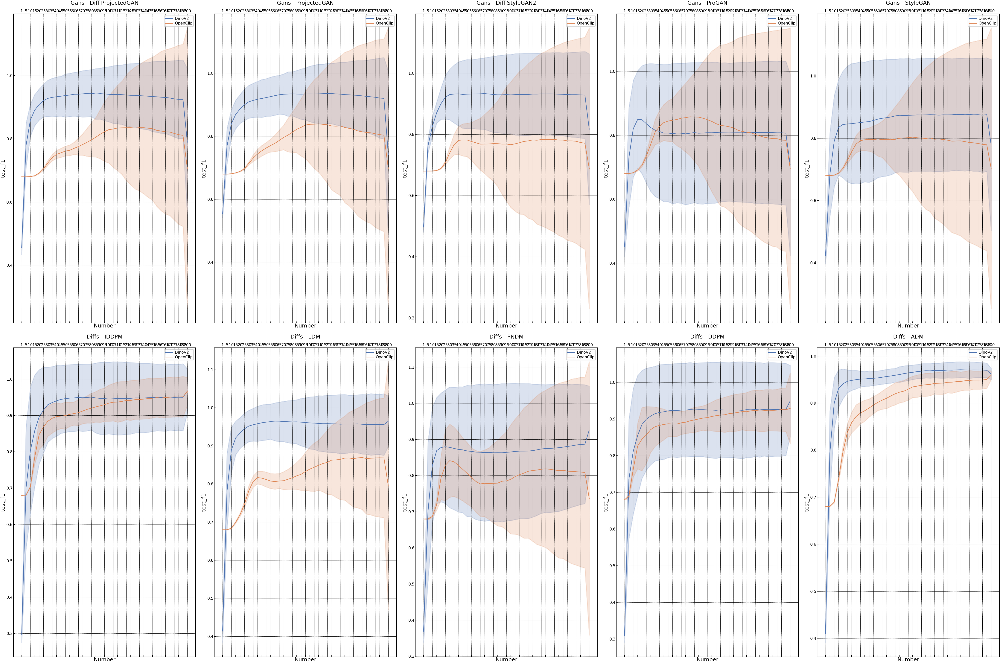

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt

data = df
data = data[data['Generator'] != "coco"]
data["Number"].replace("no", 200, inplace=True)
data["Number"] = data["Number"].astype(str)  # Convert 'Number' to string
dino_data = data[data['Encoder'] == 'DinoV2']
clip_data = data[data['Encoder'] == 'OpenClip']

sns.set_palette('deep')
head_key = "Experiment"
y = "test_f1"

# Separate experiments into Gans and Diffs
experiments_gans = [exp for exp in data[head_key].unique() if exp in Gans]
experiments_diffs = [exp for exp in data[head_key].unique() if exp in Diffs]

# Create subplots
fig, axs = plt.subplots(2, max(len(experiments_gans), len(experiments_diffs)), figsize=(18, 12))

for i, experiment in enumerate(experiments_gans):
    experiment_data_dino = dino_data[dino_data[head_key] == experiment]
    experiment_data_clip = clip_data[clip_data[head_key] == experiment]
    
    if not experiment_data_dino.empty or not experiment_data_clip.empty:
        sns.lineplot(x='Number', y=y, data=experiment_data_dino, label='DinoV2', ci='sd', estimator='mean', ax=axs[0, i])
        sns.lineplot(x='Number', y=y, data=experiment_data_clip, label='OpenClip', ci='sd', estimator='mean', ax=axs[0, i])
        axs[0, i].set_title(f'Gans - {experiment}')
    else:
        axs[0, i].text(0.5, 0.5, 'No data available', ha='center', va='center')


for j, experiment in enumerate(experiments_diffs):
    experiment_data_dino = dino_data[dino_data[head_key] == experiment]
    experiment_data_clip = clip_data[clip_data[head_key] == experiment]
    
    if not experiment_data_dino.empty or not experiment_data_clip.empty:
        sns.lineplot(x='Number', y=y, data=experiment_data_dino, label='DinoV2', ci='sd', estimator='mean', ax=axs[1, j])
        sns.lineplot(x='Number', y=y, data=experiment_data_clip, label='OpenClip', ci='sd', estimator='mean', ax=axs[1, j])
        axs[1, j].set_title(f'Diffs - {experiment}')
    else:
        axs[1, j].text(0.5, 0.5, 'No data available', ha='center', va='center')


# Adjust layout
plt.tight_layout()
plt.show()

### Analyse the impact of FDA Swichting on the Classification performance

When low frequencies from a real image are injected into a target image, a low recall rate indicates that the model is mistaking fake images for real ones. Initially, this might seem disadvantageous, as it could potentially allow the model to be tricked into classifying an altered image as genuine. However, it could also demonstrate the encoder's proficiency in processing low-level features. Ideally, this capability should result in a real image being correctly identified as real, hence a higher precision score. If the model fails to do so, it effectively creates a repository for misidentified real images. Moreover, the model may inaccurately flag images with unusual frequency characteristics as fake, even when such peculiarities arise from authentic, unaltered sources.




